# Libraries

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import csv
from copy import deepcopy

# General Function

## Read

In [2]:
def preprocess_name(imgpath, label):
    imgname = imgpath.split(".")[0]
    if label == "1":
        return imgname+"_p"
    else:
        return imgname+"_n"

def read_images(csvdir):
    with open(csvdir, newline="") as csvfile:
        imgs = dict()
        reader = csv.DictReader(csvfile)
        pcount = 0
        ncount = 0
        for row in reader:
            img_name = preprocess_name(row["ImagePath"].split("/")[-1], row["Labels"])
            bgr_img = cv2.imread(row["ImagePath"], cv2.IMREAD_UNCHANGED)
            imgs[img_name] = cv2.cvtColor(bgr_img, cv2.COLOR_BGR2RGB)
        
        return imgs

## Display

In [3]:
def display_all(imgs, subs=(84,4), fgsz=(5,170), use_gray=False):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            axs[i, j].imshow(list(imgs.values())[k], 'gray' if use_gray else None)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1
            
def display_all_with(imgs, cc, subs=(84,4), fgsz=(5,170), use_gray=True):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            axs[i, j].imshow(list(imgs.values())[k][:,:,cc], cmap='gray' if use_gray else None)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1
            
def save_plots(imgs, suptitle, savedir, subs=(84,4), fgsz=(5,170), use_gray=False):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            axs[i, j].imshow(list(imgs.values())[k], 'gray' if use_gray else None)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1
    fig.suptitle(suptitle)
    fig.savefig(savedir)
    print(f'Figure is successfully saved at {savedir}')
    
def display_all_histo(imgs, subs=(84,4), fgsz=(5,170)):
    fig, axs = plt.subplots(subs[0], subs[1], figsize=fgsz)
    k = 0
    for i in range(subs[0]):
        for j in range(subs[1]):
            # print(list(imgs.values())[k])
            sample_histo = cv2.calcHist([list(imgs.values())[k]],[0],None,[256],[0,256]) 
            axs[i, j].plot(sample_histo)
            axs[i, j].set_title(list(imgs.keys())[k])
            axs[i, j].axis('off')
            k+=1

## Draw

In [62]:
def draw_od_line(imgs, roi_line, color):
    odlines = {}
    for img in imgs:
        odlines[img] = cv2.ellipse(imgs[img], 
                                   roi_line[img], 
                                   color, 
                                   3, 
                                   cv2.LINE_AA)
    return odlines

def draw_oc_line(imgs, roi_line, color):
    drawn_oc = {}
    
    for img in imgs:
        drawn_oc[img] = cv2.circle(imgs[img],roi_line[img][0],roi_line[img][1],color, 3)
    return drawn_oc

## Preprocess

### Histogram Matching

In [5]:
from skimage.exposure import match_histograms

In [6]:
def histogram_matching(images):
    matched = {}
    ref_img = r"/home/tsdhrm/Pictures/trials/KAGGLE_RETINA/ORIGA/Images_Cropped/094.jpg"
    reference_bgr = cv2.imread(ref_img, cv2.IMREAD_UNCHANGED)
    reference = cv2.cvtColor(reference_bgr, cv2.COLOR_BGR2RGB)
    for image in images:
        matched[image] = match_histograms(images[image], reference, channel_axis=-1)
    
    return matched

### Gamma Correction

In [7]:
def adjust_gamma(image, gamma=1.0):
    inv_gamma = 1.0 / gamma
    table = np.array([((i / 255.0) ** inv_gamma) * 255 for i in np.arange(0,256)]).astype("uint8")
    return cv2.LUT(image, table)

### Remove Blood Vessel

In [8]:
def segment_vessel(imgs):
    vessel_segment = {} # for development purposes
    clahe_kernel = cv2.createCLAHE(2, (8,8))
    circular_SE = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (25,25))
    
    for img in imgs:
        # use grayscale image
        grayscale = cv2.cvtColor(imgs[img], cv2.COLOR_RGB2GRAY)
        # img negative
        img_negative = cv2.bitwise_not(grayscale)
        tophat = cv2.morphologyEx(img_negative, cv2.MORPH_TOPHAT, kernel=circular_SE)
        ret, th1 = cv2.threshold(tophat, 3, 255, cv2.THRESH_BINARY)
        vessel_segment[img] = th1
    return vessel_segment

In [9]:
def remove_bvessel(imgs):
    segmented_vessel = segment_vessel(imgs)
    without_vessel = {}
    for (k1, v1), (k2, v2) in zip(imgs.items(), segmented_vessel.items()):
        print(f'Processing {k1}...')
        without_vessel[k1] = cv2.inpaint(imgs[k1], segmented_vessel[k2], 25, cv2.INPAINT_TELEA)
    return without_vessel

## Segmentation

### Segmentasi OC

In [10]:
from skimage.exposure import rescale_intensity
from skimage.segmentation import flood, flood_fill
from skimage.filters import sobel
from skimage.segmentation import clear_border

In [11]:
def set_bleeds(img, dist=100):
    '''
    A bleed is a small area around the edge of 
    your artwork that extends beyond the “finished” 
    cut edge of your document.
    '''
    img[:, :dist] = 0
    img[:dist, :] = 0
    img[-dist:, :] = 0
    img[:, -dist:] = 0
    
    return img

In [12]:
def get_circle(contours):
    conts = np.array([contour.shape[0] for contour in contours])
    cont_idx = np.argmax(conts)
    (x,y), radius = cv2.minEnclosingCircle(contours[cont_idx])
    return (x,y), radius

def select_boundaries(bnrs):
    cont, hcy = cv2.findContours(bnrs, 
                                     cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    (x,y),radius = get_circle(cont)
    center = (int(x),int(y))
    radius = int(radius)
    return (center, radius)

In [13]:
def get_oc(images):
    # screen = {}
    boundaries = {}
    binaries = {}
    
    for image in images:
        h, w = images[image].shape[:2]
        green = images[image][:,:,1]
        rescaled = rescale_intensity(green)
        corrected = adjust_gamma(rescaled, 0.2)
        ret, th1 = cv2.threshold(corrected, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
        eroded = cv2.erode(th1, kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15,15)))
        bleeds = set_bleeds(eroded)
        closed = cv2.morphologyEx(bleeds, cv2.MORPH_CLOSE, \
                                  kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (45,45)))
        center_rad = select_boundaries(closed)
        boundaries[image] = center_rad
        canvas = np.zeros_like(th1, dtype='uint8')
        binaries[image] = cv2.circle(canvas, center_rad[0], center_rad[1], (255, 255, 255), -1)
    
    print('done')
        
    return boundaries, binaries

### Segmentasi OD

In [14]:
from skimage.feature import canny
from skimage.filters import sobel
from skimage.exposure import is_low_contrast, rescale_intensity

In [15]:
def get_which_ellipse(contours):
    conts = np.array([contour.shape[0] for contour in contours])
    cont_idx = np.argmax(conts)
    ellipse = cv2.fitEllipse(contours[cont_idx])
    return ellipse

In [73]:
def extract_od(matched):
    od_boundaries = {}
    od_binaries = {}
    screen = {}
    # display_all(p, (24,7), (10,30), True)
    
    for image in matched:
        hsv = cv2.cvtColor(matched[image], cv2.COLOR_RGB2LAB)
        v_val = hsv[:,:,0]
        gmc = adjust_gamma(v_val, 0.2)
        gmc_rescaled = rescale_intensity(gmc, 'dtype')
       # ret, th = cv2.threshold(gmc_rescaled, 'dtype') 
        ret, th = cv2.threshold(gmc_rescaled, 70, 255, cv2.THRESH_BINARY)
        closed = cv2.morphologyEx(th, \
                          cv2.MORPH_CLOSE, \
                          kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5)))
        bleed = set_bleeds(closed, dist=10)
#         bleed = set_bleeds(th, dist=25)

        erode = cv2.erode(closed, \
                          kernel=cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (35,15)))
        cont, hcy = cv2.findContours(erode, \
                                     cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
        ellipse = get_which_ellipse(cont)
        canvas = np.zeros_like(th, dtype='uint8')
        drawn_canvas = cv2.ellipse(canvas, ellipse, (255, 255, 255), -1)
        
        od_binaries[image] = drawn_canvas
        od_boundaries[image] = ellipse
        
        screen[image] = th
        
    display_all(screen, use_gray=True)
    
    print('done!')
    return od_boundaries, od_binaries

# Main

## Read

In [17]:
IMAGES_CSV = r"../selected_dataset.csv"

In [18]:
images = read_images(IMAGES_CSV)

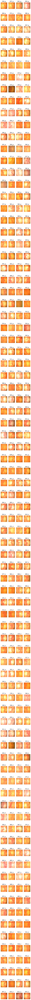

In [19]:
display_all(images)

## Histogram Matching

In [20]:
matched = histogram_matching(images)

## Blood Vessel Removal

In [21]:
no_vessel = remove_bvessel(matched)

Processing 036_p...
Processing 037_p...
Processing 041_p...
Processing 050_p...
Processing 069_p...
Processing 072_p...
Processing 076_p...
Processing 086_p...
Processing 087_p...
Processing 093_p...
Processing 094_p...
Processing 097_p...
Processing 110_p...
Processing 116_p...
Processing 138_p...
Processing 158_p...
Processing 159_p...
Processing 160_p...
Processing 165_p...
Processing 168_p...
Processing 171_p...
Processing 180_p...
Processing 181_p...
Processing 182_p...
Processing 208_p...
Processing 213_p...
Processing 225_p...
Processing 228_p...
Processing 229_p...
Processing 233_p...
Processing 240_p...
Processing 241_p...
Processing 245_p...
Processing 246_p...
Processing 247_p...
Processing 269_p...
Processing 270_p...
Processing 273_p...
Processing 277_p...
Processing 278_p...
Processing 283_p...
Processing 284_p...
Processing 285_p...
Processing 286_p...
Processing 289_p...
Processing 293_p...
Processing 294_p...
Processing 300_p...
Processing 301_p...
Processing 304_p...


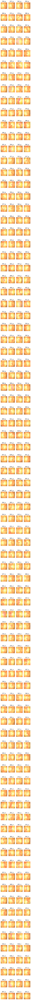

In [22]:
display_all(no_vessel)

## Segmentasi

### OC

In [23]:
oc_boundaries, oc_binaries = get_oc(no_vessel)

done


In [24]:
imgc = deepcopy(images)
drawn_oc = draw_oc_line(imgc, oc_boundaries, (0, 0, 255))

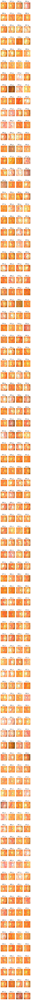

In [25]:
display_all(drawn_oc)

### OD

done!


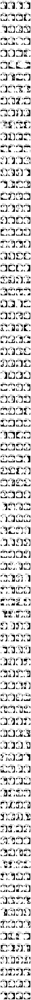

In [74]:
od_boundaries, od_binaries = extract_od(no_vessel)

In [75]:
docpy = deepcopy(drawn_oc)

In [76]:
full_drawn = draw_od_line(docpy, od_boundaries, (0, 255, 0))

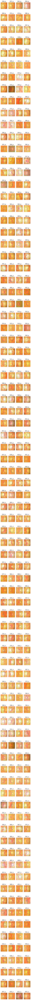

In [77]:
display_all(full_drawn)